# Metrics Validation. Dataset with 2 Lifts. 

This Notebook compares several ML-denoised versions and 2 manually denoised versions of a set of seismograms.
One set of manally denoised versions was used as targets when training models.

Metric compuation procedure is described in [Metric for evaluating difference between seismograms](./Metrics_study_intro.ipynb)

In [1]:
import sys
sys.path.append('..')

from functools import reduce

import pandas as pd

from seismicpro.batchflow import Dataset
from seismicpro.src import SeismicBatch, FieldIndex

from utils import get_cv, draw_modifications_dist, get_modifications_list, validate_all

## Data Loading

In [3]:
base_path = '/data/multiple_lift_4_metrics_validation/QC/' 
paths = {
    'lift': '1_lift.sgy',
    'lift_v1': '1_lift_v1.sgy',
    'raw': '1_raw.sgy',
    'm_1': '1_1dUnet_nomask.sgy',
    'm_2': '1_1dUnet.sgy',
    'm_3': '1_unsup.sgy',
    'm_4': '1_sup.sgy',
}

In [4]:
field_index = reduce(lambda x, y: x.merge(y), 
                     (FieldIndex(name=name, path=base_path+path, extra_headers=['offset']) for name, path in paths.items()))

In [5]:
batch = (Dataset(field_index, SeismicBatch)
         .next_batch(len(field_index))
         .load(fmt='segy', components=tuple(paths.keys())))

cv = get_cv([batch.__getattr__(c)[0] for c in batch.components])

### Fields number in data

In [6]:
len(field_index)

11

## Base lift for metrics calculation is the one on which models were trained  

Below metric $\mu$ values are computed with respect to 1-st LIFT for all seismograms

One can see that according to $\mu$ model M_2 produces the result closest to LIFT that was used in training

In [7]:
res = validate_all(batch)
pd.DataFrame(res)

,LIFT_V1_amp,LIFT_amp,M_1_amp,M_2_amp,M_3_amp,M_4_amp,RAW_amp
0,6.873391,0.0,41.144688,3.417942,67.816833,9.655366,456.683655
1,2.257816,0.0,9.004299,1.529928,8.256458,3.611828,81.794449
2,3.001026,0.0,8.348119,1.630319,11.241213,3.681849,102.182655
3,5.169468,0.0,43.905296,2.576187,68.439301,6.718940,433.403229
4,1.982107,0.0,7.406431,1.342990,9.294025,3.841424,103.582253
5,3.727628,0.0,8.957015,1.676803,18.303514,4.543062,105.778435
6,4.394864,0.0,20.999615,1.980179,51.770702,5.686204,283.429962
7,1.496290,0.0,22.184023,1.096776,17.291901,3.682863,180.119263
8,1.872853,0.0,7.780857,1.199339,28.834984,3.600789,209.218018
9,5.644798,0.0,21.710066,3.296587,30.743288,9.186719,120.295143


## Base lift for metrics calculation which was not used in model training

Here we provide $\mu$ values calculated with respect to second LIFT
The numbers in first column in both tables are identical, because $\mu$ is symmetric

In most cases model M_2 also poduces the output that is closest to second LIFT variant according to $\mu$, but for  entries 3 and 6 M_4 output is closer to the new LIFT than both M_2 output and the old LIFT.



<style scoped>
    .dataframe tbody tr th:only-of-type {
        vertical-align: middle;
    }

    .dataframe tbody tr th {
        vertical-align: top;
    }

    .dataframe thead th {
        text-align: right;
    }
</style>
<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>LIFT_OLD_amp</th>
      <th>LIFT_amp</th>
      <th>M_1_amp</th>
      <th>M_2_amp</th>
      <th>M_3_amp</th>
      <th>M_4_amp</th>
      <th>RAW_amp</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>0</th>
      <td>6.873391</td>
      <td>0.0</td>
      <td>43.981922</td>
      <td>6.552361</td>
      <td>65.794800</td>
      <td>6.637980</td>
      <td>461.496582</td>
    </tr>
    <tr>
      <th>1</th>
      <td>2.257816</td>
      <td>0.0</td>
      <td>9.859728</td>
      <td>2.974515</td>
      <td>9.034495</td>
      <td>4.623295</td>
      <td>83.286186</td>
    </tr>
    <tr>
      <th>2</th>
      <td>3.001026</td>
      <td>0.0</td>
      <td>9.440042</td>
      <td>3.845727</td>
      <td>11.920689</td>
      <td>4.195026</td>
      <td>104.315544</td>
    </tr>
    <tr>
      <th>3</th>
      <td>5.169468</td>
      <td>0.0</td>
      <td>46.823658</td>
      <td>5.337018</td>
      <td>67.171944</td>
      <td>4.801869</td>
      <td>437.032562</td>
    </tr>
    <tr>
      <th>4</th>
      <td>1.982107</td>
      <td>0.0</td>
      <td>8.170703</td>
      <td>2.633882</td>
      <td>10.010674</td>
      <td>4.754464</td>
      <td>104.884338</td>
    </tr>
    <tr>
      <th>5</th>
      <td>3.727628</td>
      <td>0.0</td>
      <td>10.398363</td>
      <td>4.331355</td>
      <td>18.728949</td>
      <td>4.597432</td>
      <td>108.410660</td>
    </tr>
    <tr>
      <th>6</th>
      <td>4.394864</td>
      <td>0.0</td>
      <td>23.239050</td>
      <td>4.773645</td>
      <td>50.954643</td>
      <td>4.335797</td>
      <td>286.483063</td>
    </tr>
    <tr>
      <th>7</th>
      <td>1.496290</td>
      <td>0.0</td>
      <td>22.781954</td>
      <td>1.941341</td>
      <td>17.708498</td>
      <td>4.151761</td>
      <td>180.922211</td>
    </tr>
    <tr>
      <th>8</th>
      <td>1.872853</td>
      <td>0.0</td>
      <td>8.590627</td>
      <td>2.435302</td>
      <td>29.088499</td>
      <td>3.833971</td>
      <td>210.419067</td>
    </tr>
    <tr>
      <th>9</th>
      <td>5.644798</td>
      <td>0.0</td>
      <td>23.803978</td>
      <td>5.952668</td>
      <td>29.911592</td>
      <td>6.494111</td>
      <td>124.230545</td>
    </tr>
    <tr>
      <th>10</th>
      <td>2.645763</td>
      <td>0.0</td>
      <td>12.351575</td>
      <td>3.265245</td>
      <td>12.291306</td>
      <td>4.872962</td>
      <td>98.935356</td>
    </tr>
  </tbody>
</table>

Below all seismograms and their difference with LIFT used in training are shown for reference

Field 0


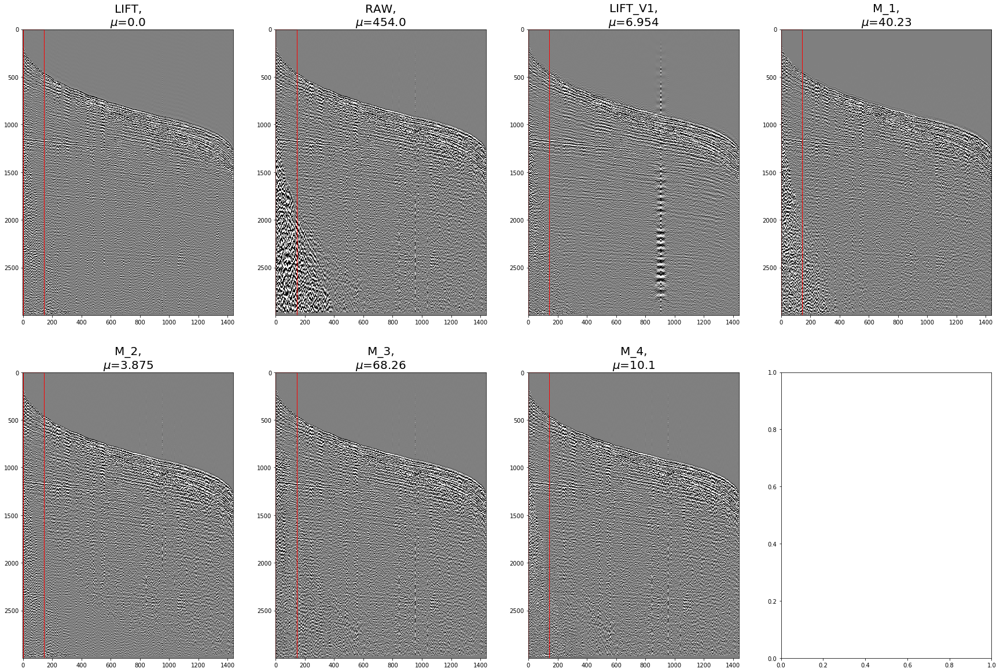

In [8]:
i=0
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 1


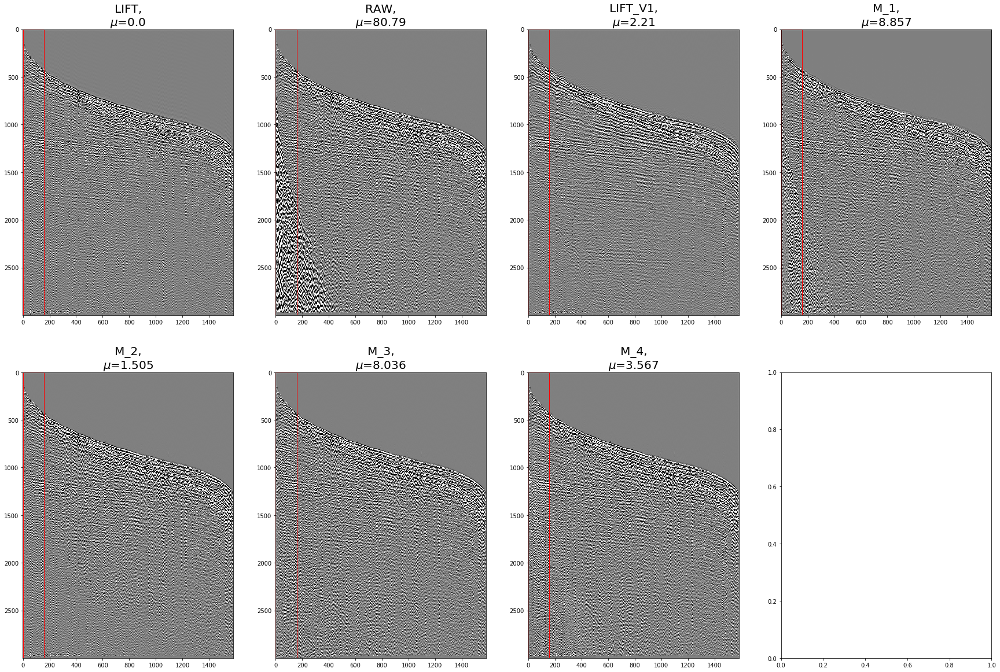

In [9]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 2


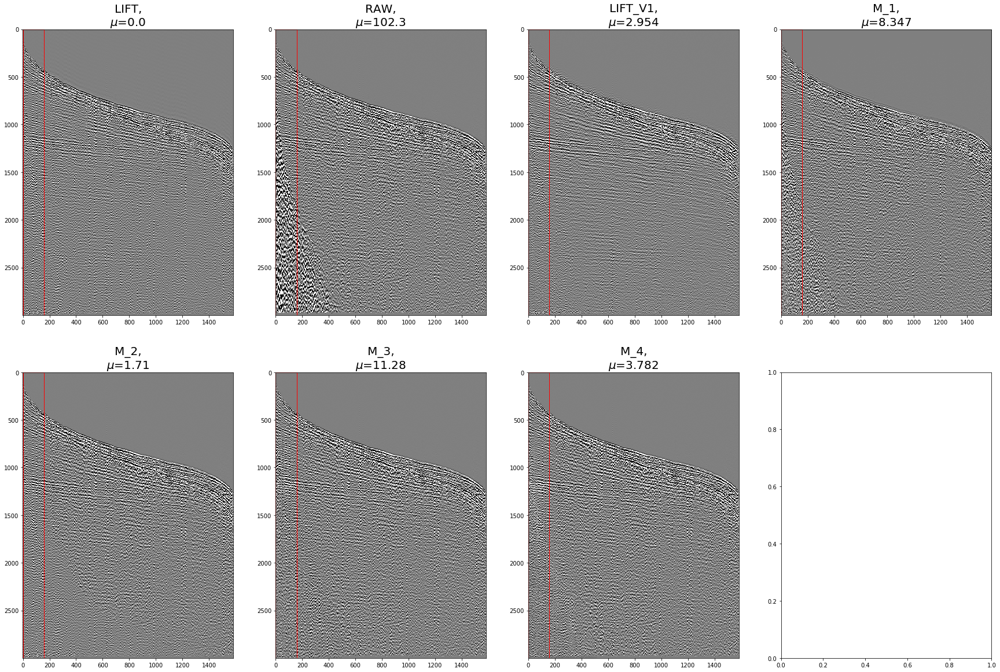

In [10]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 3


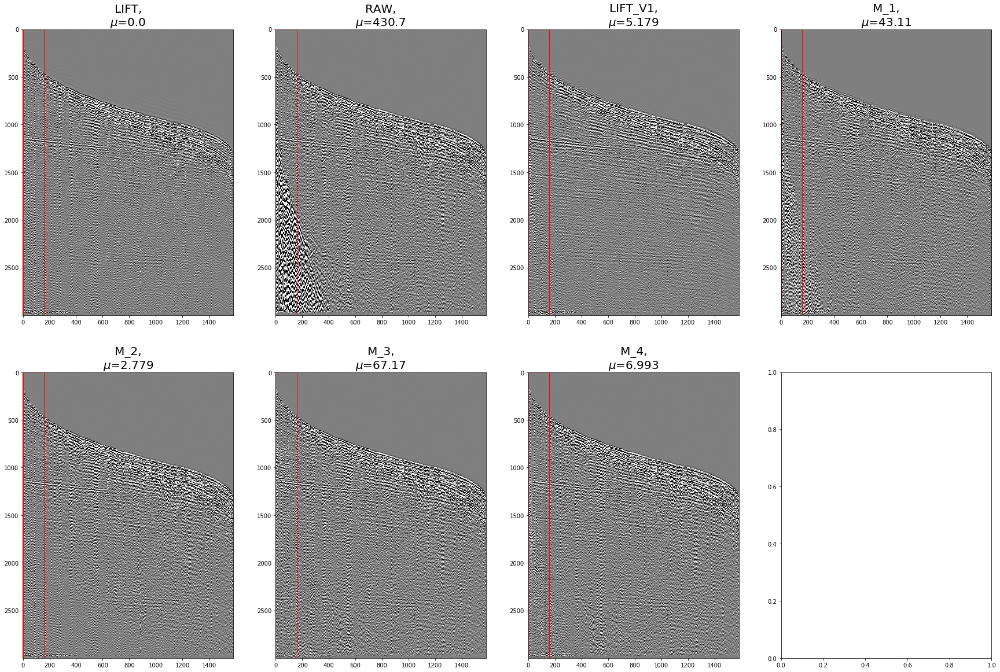

In [11]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 4


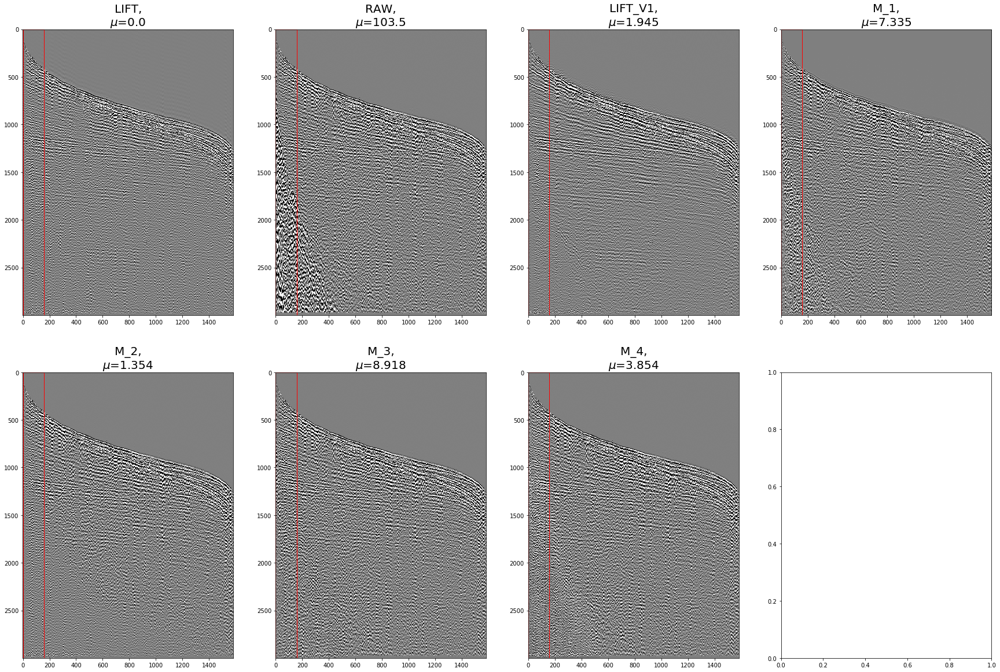

In [12]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 5


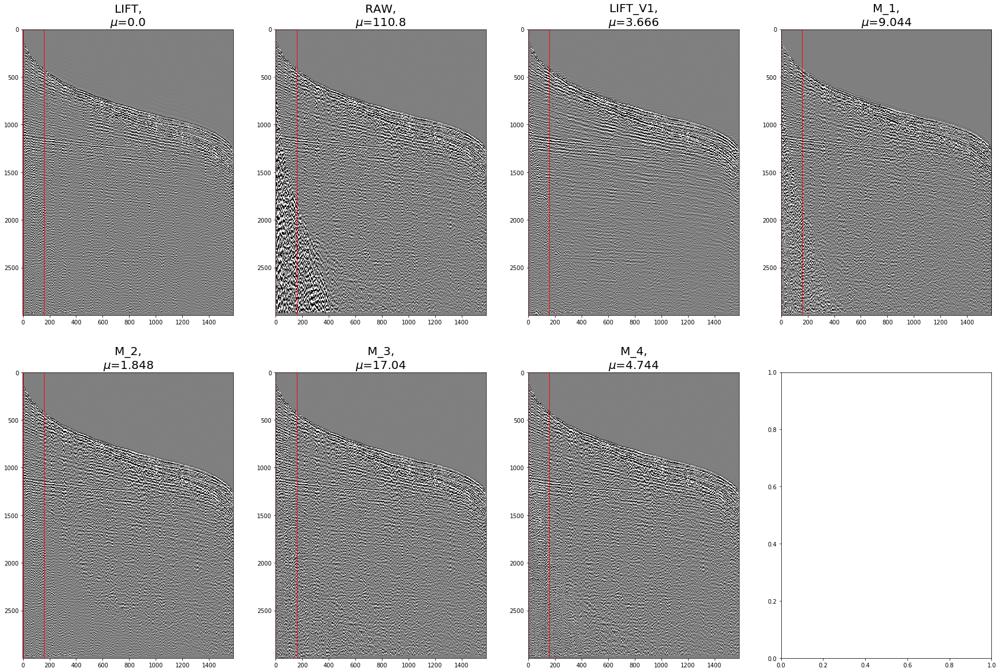

In [13]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 6


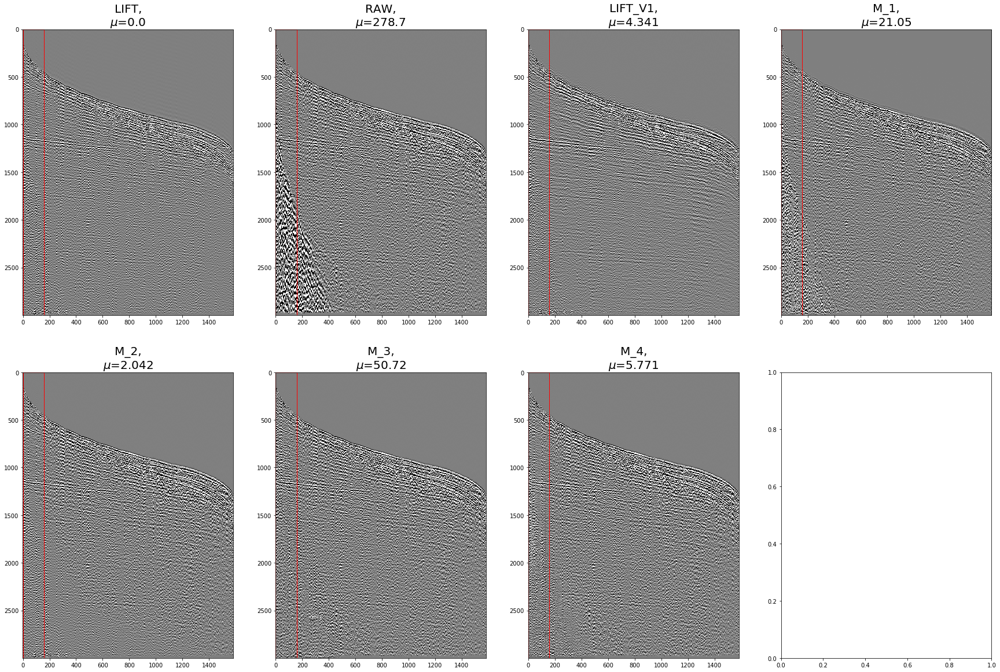

In [14]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 7


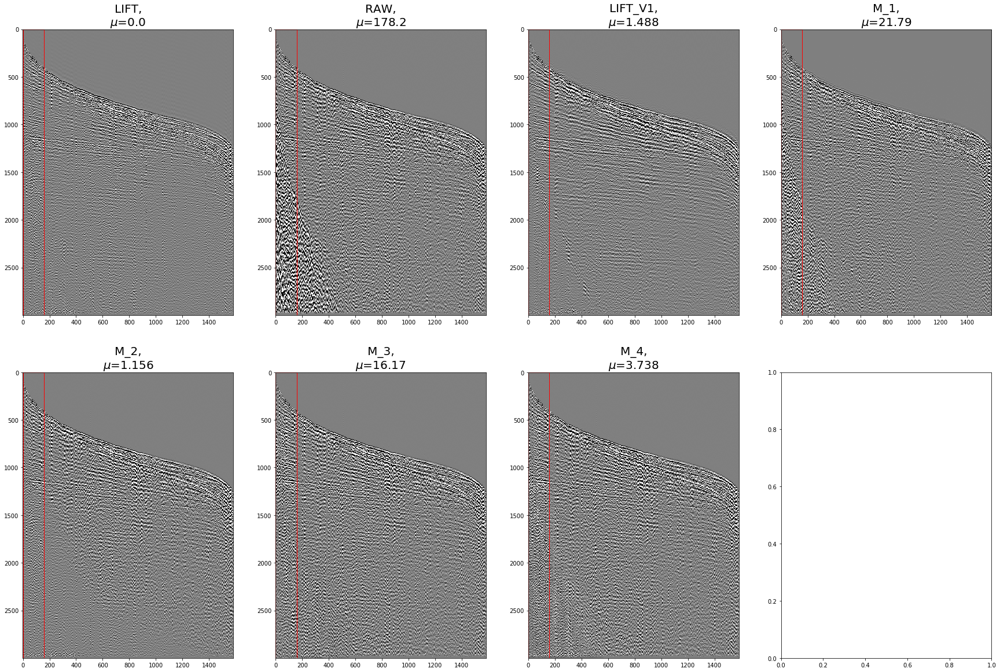

In [15]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 8


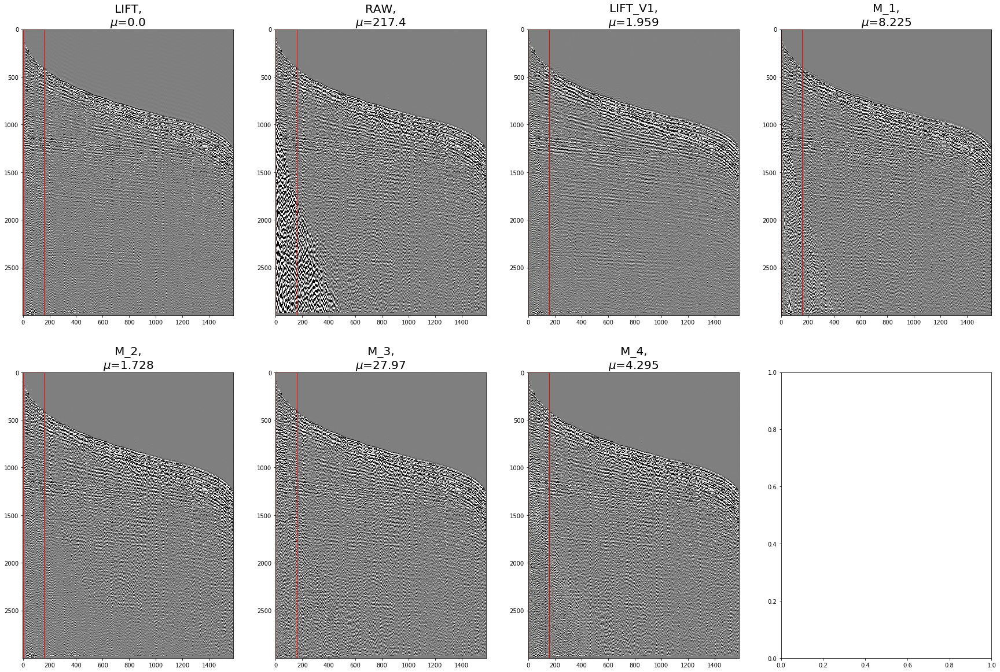

In [16]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 9


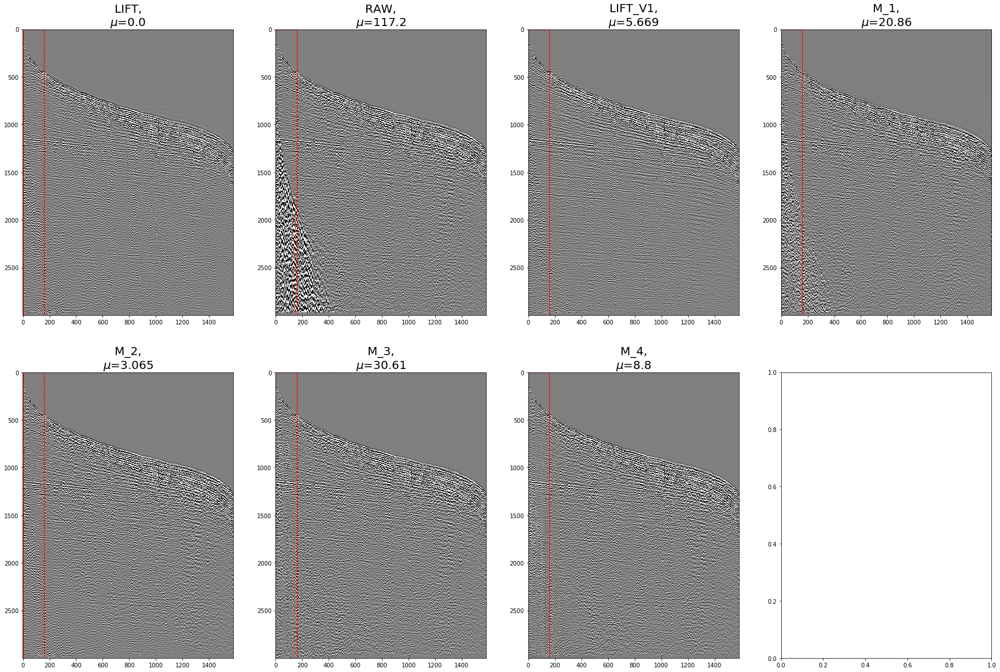

In [17]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 10


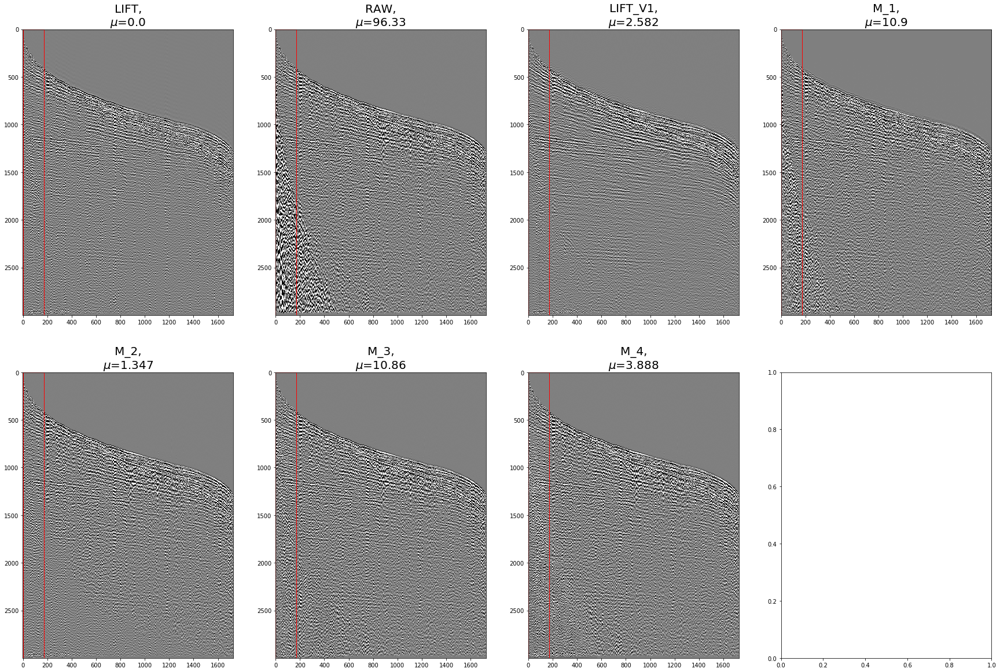

In [18]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1